
<h1>Virus Simulation on Graph</h1>

Community interaction can be represented as graphs where a node represents a person and an edge represents an interaction. Initially the virus start from one person and he or she is coverly infected. SEIR model is used to implement this. At each iteration, covertly infected persons can spread the virus to their neighbors at a probablity of P. Once shown symptoms, a person (node) becomes isolated (remove all edges associated with it). The spreading of the virus is measured by the final infected populations.<br>

<b> Particularly We want to study the following variables: <br>

- Infection Probability
- Degree of Graph
- Covert Period
- Quarantine Method

</b>

<b> Next we investigate two type of graphs to observe if graph with the same average degree always end up the same outcomes:

- Connected Cavemen Graph (Ring of Cliques)
- Lancichinetti–Fortunato–Radicchi Benchmark Graph

</b>

Connected Cavemen graph resembles small community that consist of family of size K, and we have strong reason to believe that this is the graph topology to achieve lowest infection at known average degrees. <br>
LFR graph is another widely recongized graph representation of inter-community interactions. In this simulation, LFR graph is mainly investigated and tested against different set of parameters.    

We also simulated the social distancing, quanrantine, aggressive quanrantine and the covert period affact the spread of the virus. <br>



In [19]:
import networkx as nx
import pandas as pd
import numpy as np
from enum import Enum
import random
from matplotlib import animation, rc
import matplotlib.pyplot as plt
from copy import deepcopy
import ipywidgets as widgets
from ipywidgets import interact, interactive, fixed, interact_manual

import matplotlib.pyplot as plt
import mplcyberpunk


<h3> Connected Cavemen Graph </h3>

Connected Cavemen Graph is a ring of cliques. Run the following code multiple times to generate a good layout.

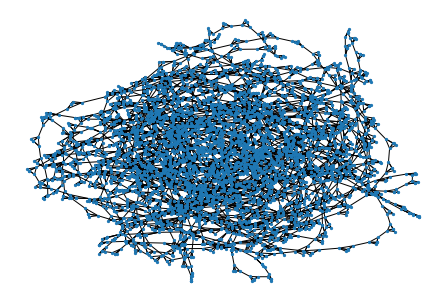

In [56]:
ccg = nx.generators.community.connected_caveman_graph(1000,5)
ccg_pos = nx.layout.spring_layout(ccg)
nx.draw(ccg, node_size=5, pos=ccg_pos)

<h3> Lancichinetti–Fortunato–Radicchi Benchmark Graph </h3>

Connected Cavemen Graph is a ring of cliques. Run the following code multiple times to generate a good layout. A LFR benchmark with clustered layout looks like this:
<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/d/d2/Internet_map_1024.jpg/1024px-Internet_map_1024.jpg" alt="LFR benchmark" height="500" width="300">


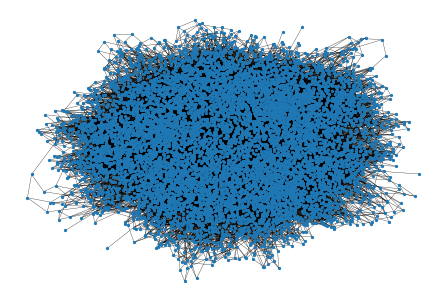

In [8]:
lfr5 = nx.generators.community.LFR_benchmark_graph(10000,3,1.1,0.1,average_degree=5,max_degree=10,min_community=50,max_community=80,max_iters=500)
lfr5_pos = nx.layout.spring_layout(lfr5)
nx.draw(lfr5, node_size=5, pos=lfr5_pos, width=0.3)

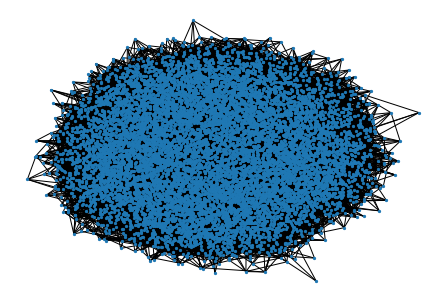

In [52]:
lfr7 = nx.generators.community.LFR_benchmark_graph(10000,3,1.1,0.1,average_degree=7,max_degree=12,min_community=50,max_community=80,max_iters=500)
lfr7_pos = nx.layout.spring_layout(lfr7)
nx.draw(lfr7, node_size=5, pos=lfr7_pos)

<h2> Simulation <h2>

In [14]:
class Condition(Enum):
  HEALTHY = 1
  COVERT = 2
  INFECTED = 3

class Quarantine(Enum):
  NONE = 1
  BASIC = 2
  AGGRESSIVE = 3

def initialize(G, covert_days=5, quarantine=Quarantine.BASIC, probability=0.1):
  G.graph['covert_days'] = covert_days
  G.graph['quarantine'] = quarantine
  G.graph['probability'] = probability
  for v in G:
    G.nodes[v]['condition'] = Condition.HEALTHY
    G.nodes[v]['color'] = 'Green'
    G.nodes[v]['covert_countdown'] = covert_days
  G.nodes[0]['condition'] = Condition.COVERT
  G.graph['nInfected'] = [1]
  G.graph['nCovert'] = [0]

def nextState(G):
  new_covertly = set()
  new_infected = set()
  for v in G.nodes():
    if  G.nodes[v]['condition'] == Condition.INFECTED:
      pass
    elif G.nodes[v]['condition'] == Condition.COVERT:
      if G.nodes[v]['covert_countdown'] <= 0:
        new_infected.add(v)
      else:
        G.nodes[v]['covert_countdown']-=1
    elif  G.nodes[v]['condition'] == Condition.HEALTHY:
      for neighbor in G.neighbors(v):
        if G.nodes[neighbor]['condition'] != Condition.HEALTHY:
          if random.random() < G.graph['probability']:
            new_covertly.add(v)
  G.graph['nInfected'].append(G.graph['nInfected'][-1] + len(new_infected))
  G.graph['nCovert'].append(G.graph['nCovert'][-1] + len(new_covertly))
  return [new_covertly, new_infected]

def updateGraph(G, new_covertly, new_infected):
  for v in new_covertly:
    G.nodes[v]['condition'] = Condition.COVERT
    G.nodes[v]['color'] = 'Yellow'
  for v in new_infected:
    G.nodes[v]['condition'] = Condition.INFECTED
    G.nodes[v]['color'] = 'Red'
    if G.graph['quarantine'] == Quarantine.AGGRESSIVE:
      for neighbor in frozenset(G.neighbors(v)):
        for neighbor2 in frozenset(G.neighbors(neighbor)):
          G.remove_edge(neighbor2, neighbor)
    elif G.graph['quarantine'] == Quarantine.BASIC:
      for neighbor in frozenset(G.neighbors(v)):
        G.remove_edge(neighbor, v)

def update(num):
    ax1.clear()
    [new_covertly, new_infected] = nextState(G)
    updateGraph(G, new_covertly, new_infected)
    colorMap = [G.nodes[v]['color'] for v in G]
    nx.draw(G, pos=pos, ax=ax1, node_size=10, node_color=colorMap)
    ax1.set_title("Day %d: "%(num+2), fontweight="bold")

    ax2.clear()
    ax2.plot(list(range(num+2)),G.graph['nInfected'][:num+2], color='R')
    ax2.plot(list(range(num+2)),G.graph['nCovert'][:num+2], color='Y')
    ax2.set_xlim(left=0,right=nDays)
    ax2.set_ylim(bottom=0, top=G.number_of_nodes())
    ax2.set_title("Cumulative Cases")

def simulate():
    for i in range(nDays):
        [new_covertly, new_infected] = nextState(G)
        updateGraph(G, new_covertly, new_infected)


<h2> Simulation on LFR Benchmark (Avg Degree = 5) with 10000 population<h2>

In [12]:
G = deepcopy(lfr5) # Make a deep copy so that the original graph remain intact
pos = lfr5_pos

<h2> Quarantine Method Sensitivity Study </h2>
    
Three Quarantine methods were investigated:
- None: No quarantine
- Basic: When an individual becomes infected, isolate him or her from the community (Remove all edges)
- Aggresive: When an individual becomes infected, isolate him/her and his or her neighbors from the community.

The result shows only aggressive quarantine is much more effective than the basic when infection probability is 0.1 and the covert days is 5.

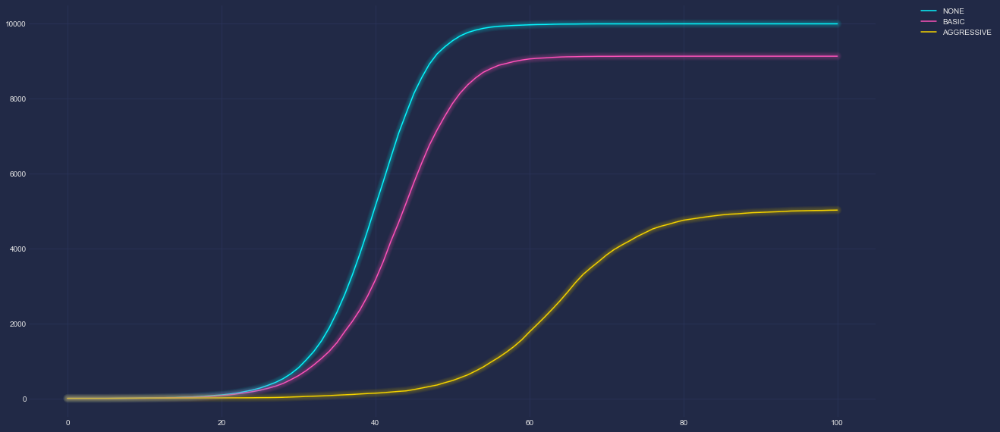

In [44]:
plt.figure(figsize=(20,10))
for quarantine in Quarantine:
    G = deepcopy(lfr5)
    covert_days = 5
    infection_probability = 0.1
    nDays = 100
    initialize(G, covert_days, quarantine, infection_probability) 
    simulate()
    plt.plot(G.graph['nInfected'], label=quarantine.name)

plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
mplcyberpunk.make_lines_glow()
plt.show()


<h2> Infection Probability Sensitivity Study </h2>

We define the infection probability as the chance of contracting the virus per interaction with a infected person.

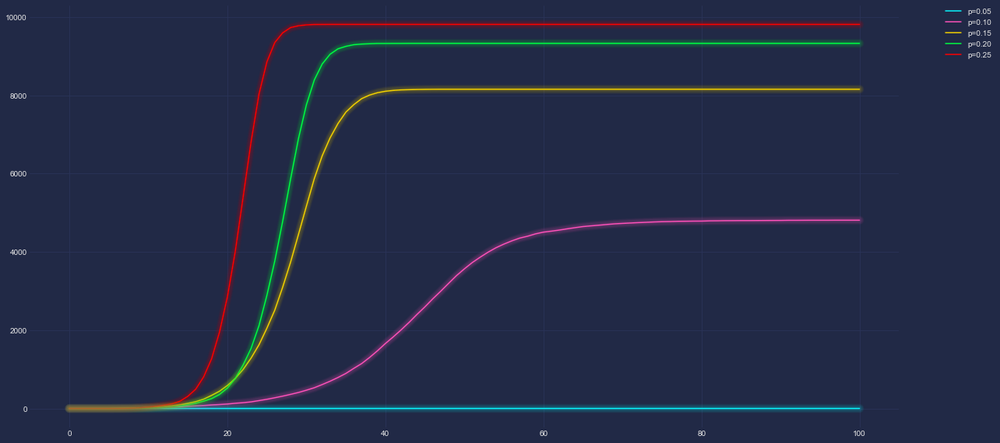

In [45]:
plt.figure(figsize=(20,10))
for infection_probability in np.arange(0.05,0.3,0.05):
    G = deepcopy(lfr5)
    covert_days = 5
    nDays = 100
    quarantine=Quarantine.AGGRESSIVE
    initialize(G, covert_days, quarantine, infection_probability) 
    simulate()
    plt.plot(G.graph['nInfected'], label='p={:.2f}'.format(infection_probability))

plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
mplcyberpunk.make_lines_glow()
plt.show()


<h2> Covert Period Sensitivity Study </h2>

Next we investigate how the average length of the covert period affacts the spreading of the virus. In the simulation, we assumed all infected person will show symptoms exactly after the Kth days.

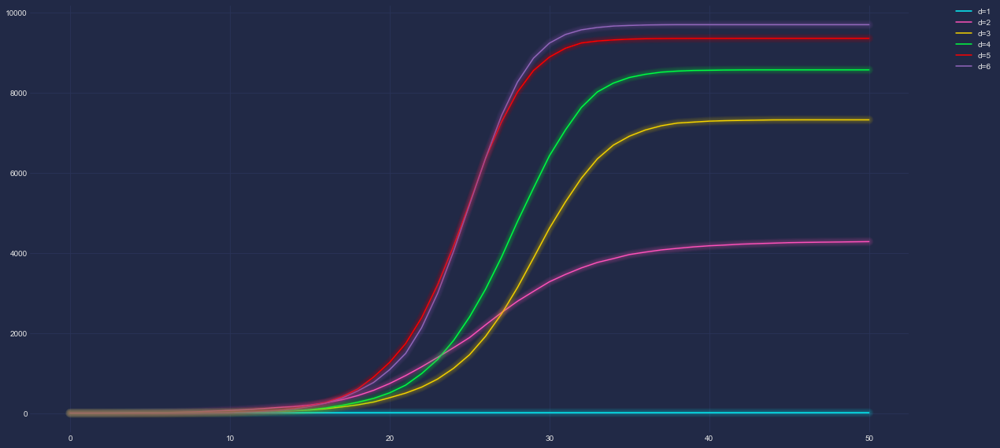

In [40]:
plt.figure(figsize=(20,10))
for covert_days in range(1,7,1):
    G = deepcopy(lfr5)
    infection_probability = 0.2
    nDays = 50
    quarantine=Quarantine.AGGRESSIVE
    initialize(G, covert_days, quarantine, infection_probability) 
    simulate()
    plt.plot(G.graph['nInfected'], label='d='+str(covert_days))

plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
mplcyberpunk.make_lines_glow()
plt.show()

<h2> Average Degree of Graph Sensitivity Study </h2>

Finally we investigate how sensitive the spreading of the virus is regarding to the degree of the graph. From the result it is clear that the higher the average degree of the graph, the faster the virus spreads. 

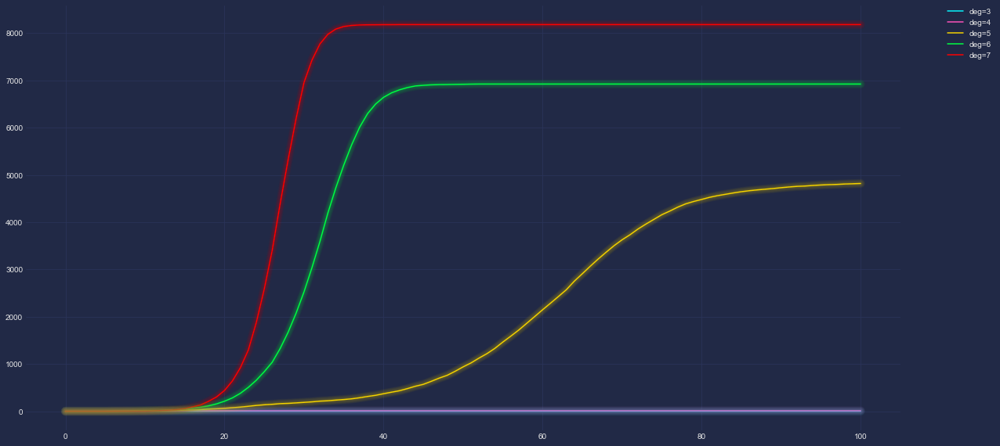

In [48]:
plt.figure(figsize=(20,10))
for deg in range(3,8):
    G = nx.generators.community.LFR_benchmark_graph(10000,3,1.1,0.1,average_degree=deg,max_degree=deg*2,min_community=50,max_community=80,max_iters=500)
    infection_probability = 0.1
    nDays = 100
    covert_days = 5
    quarantine=Quarantine.AGGRESSIVE
    initialize(G, covert_days, quarantine, infection_probability) 
    simulate()
    plt.plot(G.graph['nInfected'], label='deg='+str(deg))
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
mplcyberpunk.make_lines_glow()
plt.show()

<h2> Animations of the spreading </h2>

We now show that the result of the spreading can vary greatly even for two graphs with the same average degree. We use an extreme graph case to show our observation, connected cavemen graph. <br>
As it is shown below, the two graph with same average degree and inital setup, ended up with completely different outcomes. In LFR, eventually the virus almost infected the whole network, and in connected cavemen, the virus stopped at a very early stage.

<h3> LFR, degree of 5 </h3>

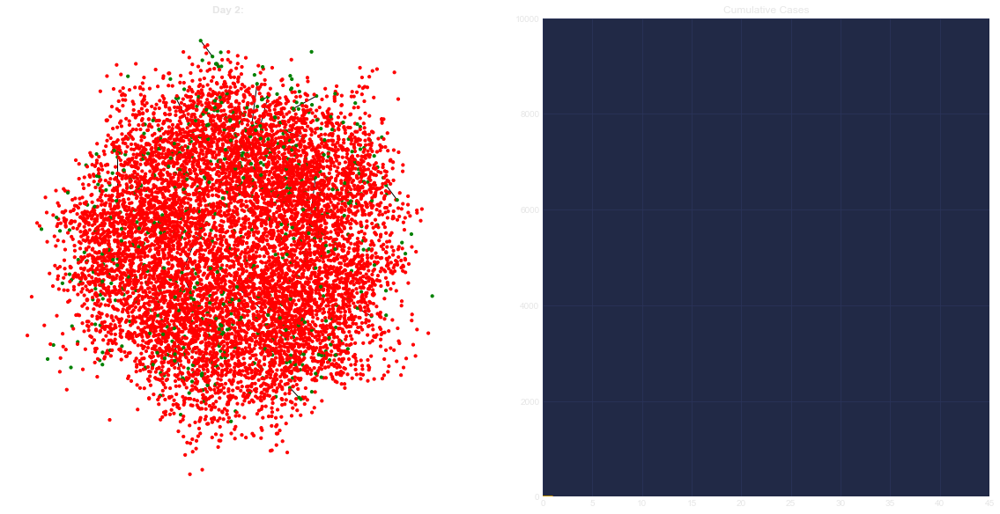

In [58]:
G = deepcopy(lfr5) # Make a deep copy so that the original graph remain intact
pos = lfr5_pos
covert_days = 5
nDays = 45
quarantine=Quarantine.AGGRESSIVE
infection_probability = 0.2
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
initialize(G, covert_days, quarantine, infection_probability) 
ani = animation.FuncAnimation(fig, update, frames=nDays, interval=1000, cache_frame_data=False)
rc('animation', html='jshtml')
ani

<h3> Connected Cavemen, Clique of 5 </h3>

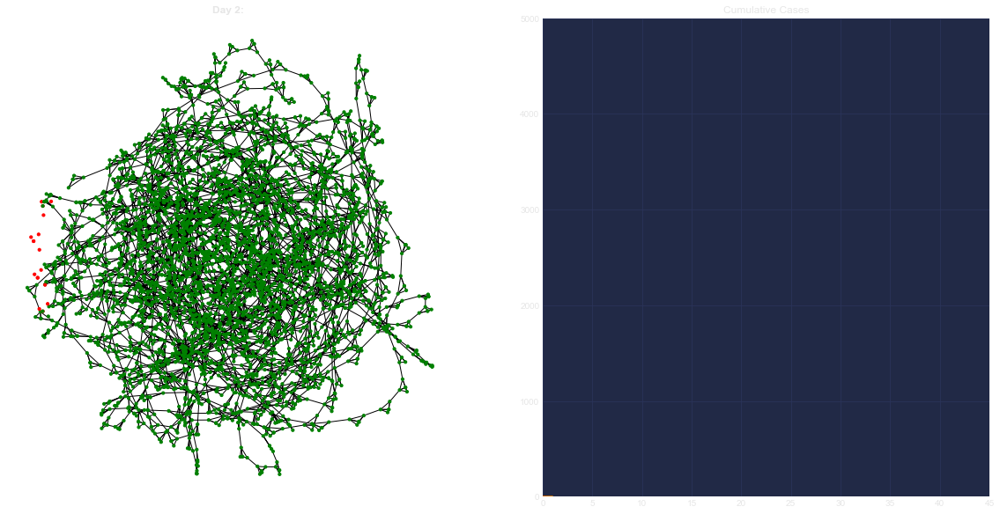

In [59]:
G = deepcopy(ccg) # Make a deep copy so that the original graph remain intact
pos = ccg_pos
covert_days = 5
nDays = 45
quarantine=Quarantine.AGGRESSIVE
infection_probability = 0.2
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
initialize(G, covert_days, quarantine, infection_probability) 
ani = animation.FuncAnimation(fig, update, frames=nDays, interval=1000, cache_frame_data=False)
rc('animation', html='jshtml')
ani

<h2> Conclusions </h2>

The spreading speed of the virus is:

- highly sensitive to the infected probability
- highly sensitive to the quarantine method
- somewhat sensitive to the infected probability
- sensitive to the average degree of the graph (for same type of graph)

We further showed that the even two graphs with the same average degree, the spreading speed of the virus can vary greatly.